In [1]:
import numpy as np
from scipy.spatial import cKDTree
import pyvista as pv
import matplotlib.pyplot as plt
import mayavi
import pandas as pd
import trimesh
import pymesh
import open3d as o3d
import vtk
from scipy.spatial import KDTree
from mpl_toolkits.mplot3d.art3d import Poly3DCollection
import plotly.graph_objects as go
import os
import ast
import json
from scipy.spatial.distance import directed_hausdorff
from scipy.spatial.distance import cdist
# import subprocess
# import ipyvolume as ipv

Jupyter environment detected. Enabling Open3D WebVisualizer.
[Open3D INFO] WebRTC GUI backend enabled.
[Open3D INFO] WebRTCWindowSystem: HTTP handshake server disabled.


In [23]:
# subprocess.run(["jupyter", "nbextension", "enable", "--py", "widgetsnbextension", "--sys-prefix"])

CompletedProcess(args=['jupyter', 'nbextension', 'enable', '--py', 'widgetsnbextension', '--sys-prefix'], returncode=1)

In [5]:
def simplify_model(mesh, reduction_factor):

    # Perform mesh simplification
    # The parameter `factor` determines the reduction factor (0.0 to 1.0)
    # For example, factor=0.5 will reduce the number of faces by approximately half.
    target_faces = len(mesh.faces) * reduction_factor  # Example target: reduce to 10%
    simplified_mesh = mesh.simplify_quadric_decimation(target_faces)

    return simplified_mesh


# Directory containing the mesh files
mesh_directory = './models'

# List all files in the directory
files = os.listdir(mesh_directory)

# Group files into pairs
mesh_pairs = []
for file in files:
    if 'skull' in file:
        skin_file = file.replace('skull', 'skin')
        if skin_file in files:
            mesh_pairs.append((file, skin_file))

# Dataframe to store face count information
face_count_data = []

# Process each pair
for skull_file, skin_file in mesh_pairs:
    print(f"Processing {skull_file} and {skin_file}...")
    
    # Load the meshes
    mesh1 = trimesh.load(os.path.join(mesh_directory, skull_file))
    mesh2 = trimesh.load(os.path.join(mesh_directory, skin_file))

    # Original number of faces
    original_faces_mesh1 = len(mesh1.faces)
    original_faces_mesh2 = len(mesh2.faces)
    
    
    # Symplify meshes
    simplified_mesh1 = simplify_model(mesh1, 0.1)
    simplified_mesh2 = simplify_model(mesh2, 0.1)

    # New number of faces
    simplified_faces_mesh1 = len(simplified_mesh1.faces)
    simplified_faces_mesh2 = len(simplified_mesh2.faces)

    simplified_mesh1_file = os.path.join(mesh_directory, f"simplified_{skull_file.replace('.stl', '')}.stl")
    simplified_mesh2_file = os.path.join(mesh_directory, f"simplified_{skin_file.replace('.stl', '')}.stl")
    
    simplified_mesh1.export(simplified_mesh1_file)
    simplified_mesh2.export(simplified_mesh2_file)
    
    print(f"Simplified meshes saved as {simplified_mesh1_file} and {simplified_mesh2_file}")
    
    # Add data to the dataframe
    face_count_data.append({
        "Model": skull_file,
        "Initial Faces": original_faces_mesh1,
        "Simplified Faces": simplified_faces_mesh1
    })
    
    face_count_data.append({
        "Model": skin_file,
        "Initial Faces": original_faces_mesh2,
        "Simplified Faces": simplified_faces_mesh2
    })

# Create a dataframe and save it to a CSV file
df_face_counts = pd.DataFrame(face_count_data)
df_face_counts.to_csv(os.path.join(mesh_directory, 'face_counts.csv'), index=False)


Processing F1.5. F24 skull.stl and F1.5. F24 skin.stl...
Simplified meshes saved as ./models\simplified_F1.5. F24 skull.stl and ./models\simplified_F1.5. F24 skin.stl
Processing F2.3. F27 skull.stl and F2.3. F27 skin.stl...
Simplified meshes saved as ./models\simplified_F2.3. F27 skull.stl and ./models\simplified_F2.3. F27 skin.stl
Processing F25 EH skull.stl and F25 EH skin.stl...
Simplified meshes saved as ./models\simplified_F25 EH skull.stl and ./models\simplified_F25 EH skin.stl
Processing F27 skull.stl and F27 skin.stl...
Simplified meshes saved as ./models\simplified_F27 skull.stl and ./models\simplified_F27 skin.stl
Processing F3.11. F31 skull.stl and F3.11. F31 skin.stl...
Simplified meshes saved as ./models\simplified_F3.11. F31 skull.stl and ./models\simplified_F3.11. F31 skin.stl
Processing F3.9. F34 skull.stl and F3.9. F34 skin.stl...
Simplified meshes saved as ./models\simplified_F3.9. F34 skull.stl and ./models\simplified_F3.9. F34 skin.stl
Processing F4.10. F37 skull.st

In [9]:
for index, row in df_face_counts.iterrows():
    print(f"Original number of faces of the {row['Model']} model: {row['Initial Faces']}")
    print(f"Simplified number of faces of the {row['Model']} model: {row['Simplified Faces']}")
    print("\n")

Original number of faces of the F1.5. F24 skull.stl model: 721515
Simplified number of faces of the F1.5. F24 skull.stl model: 72151


Original number of faces of the F1.5. F24 skin.stl model: 499614
Simplified number of faces of the F1.5. F24 skin.stl model: 49961


Original number of faces of the F2.3. F27 skull.stl model: 628055
Simplified number of faces of the F2.3. F27 skull.stl model: 62805


Original number of faces of the F2.3. F27 skin.stl model: 474984
Simplified number of faces of the F2.3. F27 skin.stl model: 47497


Original number of faces of the F25 EH skull.stl model: 721899
Simplified number of faces of the F25 EH skull.stl model: 72188


Original number of faces of the F25 EH skin.stl model: 473709
Simplified number of faces of the F25 EH skin.stl model: 47369


Original number of faces of the F27 skull.stl model: 662206
Simplified number of faces of the F27 skull.stl model: 66220


Original number of faces of the F27 skin.stl model: 517297
Simplified number of faces

In [18]:
# Calculate the distances from vertices of mesh1 to mesh2 based on the closest distance
def calculate_closest_distances(mesh1, mesh2):
    mesh_1 = pv.wrap(mesh1)
    mesh_2 = pv.wrap(mesh2)
    
    # Create k-d tree for mesh1
    tree = cKDTree(mesh_1.points)

    # List to store distances
    distances = []

    # Iterate through vertices of mesh2 and find closest points
    for point in mesh_2.points:
        _, idx = tree.query(point)
        closest_point = mesh_1.points[idx]
        distance = np.linalg.norm(point - closest_point)
        distances.append(distance)

    return np.array(distances)

# Directory containing the mesh files
mesh_directory = './models'

# List all files in the directory
files = os.listdir(mesh_directory)

# Group files into pairs
mesh_pairs = []
for file in files:
    if 'simplified' in file:
        if 'skull' in file:
            skin_file = file.replace('skull', 'skin')
            if skin_file in files:
                mesh_pairs.append((file, skin_file))

# Dataframe to store distance statistics
distance_stats = []

# Define distance ranges
distance_ranges = [(0.01, 5), (5, 10), (10, 15), (15, 20), (20, 25), (25, 30), (30, 35), (35, 40), (40, 45), (45, 50)]

# Process each pair
for skull_file, skin_file in mesh_pairs:
    print(f"Processing {skull_file} and {skin_file}...")
    
    # Load the meshes
    mesh1 = trimesh.load(os.path.join(mesh_directory, skull_file))
    mesh2 = trimesh.load(os.path.join(mesh_directory, skin_file))
    
    # Calculate distances
    distances = calculate_closest_distances(mesh1, mesh2)

    
    stats_dict = {}
    
    # Calculate statistics for each range
    for distance_range in distance_ranges:
        range_min, range_max = distance_range
        range_distances = distances[(distances >= range_min) & (distances < range_max)]
        mean_distance = np.mean(range_distances)
        count_distance = len(range_distances)
        relative_count = (count_distance / len(distances)) * 100

        # Store statistics in dictionary
        stats_dict[f"Range {range_min}-{range_max} (mm)"] = {
            "Mean Distance (mm)": mean_distance,
            "Count": count_distance,
            "Relative Count (%)": relative_count
        }
        
    # Add pair stats to distance_stats list
    pair_stats = {
        "Model": skull_file,
        **stats_dict  # Unpack stats_dict into the dictionary
    }
    distance_stats.append(pair_stats)


# Create a dataframe and save it to a CSV file
df_distance_stats = pd.DataFrame(distance_stats)
df_distance_stats.to_csv(os.path.join(mesh_directory, 'closest_distances_stats.csv'), index=False)

print("Distance statistics saved to distance_stats.csv")

Processing simplified_F1.5. F24 skull.stl and simplified_F1.5. F24 skin.stl...


C:\Users\diton\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
C:\Users\diton\anaconda3\Lib\site-packages\numpy\core\_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


Processing simplified_F2.3. F27 skull.stl and simplified_F2.3. F27 skin.stl...
Processing simplified_F25 EH skull.stl and simplified_F25 EH skin.stl...
Processing simplified_F27 skull.stl and simplified_F27 skin.stl...
Processing simplified_F3.11. F31 skull.stl and simplified_F3.11. F31 skin.stl...
Processing simplified_F3.9. F34 skull.stl and simplified_F3.9. F34 skin.stl...
Processing simplified_F4.10. F37 skull.stl and simplified_F4.10. F37 skin.stl...
Processing simplified_F4.9. F35 skull.stl and simplified_F4.9. F35 skin.stl...
Processing simplified_F5.24. F43 skull.stl and simplified_F5.24. F43 skin.stl...
Processing simplified_F5.25. F44 skull.stl and simplified_F5.25. F44 skin.stl...
Processing simplified_M1.6. M23 skull.stl and simplified_M1.6. M23 skin.stl...
Processing simplified_M2.5. M25 skull.stl and simplified_M2.5. M25 skin.stl...
Processing simplified_M2.6. M29 skull.stl and simplified_M2.6. M29 skin.stl...
Processing simplified_M2.7. M28 skull.stl and simplified_M2.7.

In [49]:
df_distance_stats = pd.read_csv("models/closest_distances_stats.csv")

# Function to parse dictionary-like string into a dictionary
def parse_stats_string(stats_str):
    try:
        return json.loads(stats_str.replace("'", '"'))  # Replace single quotes with double quotes for valid JSON
    except json.JSONDecodeError:
        return None

# Iterate through each row in the DataFrame
for index, row in df_distance_stats.iterrows():
    model = row['Model']
    print(f"Statistics for {model}:")
    
    # Iterate through each range and extract statistics
    for col in df_distance_stats.columns:
        if col.startswith('Range'):
            range_stats_str = row[col]
            range_name = col.replace(' (mm)', '')  # Remove '(mm)' from range name
            
            # Parse string representation into dictionary
            range_stats = parse_stats_string(range_stats_str)
            
            if range_stats:
                # Extract and print statistics
                print(f"{range_name}:")
                print(f"\tMean Distance (mm): {range_stats['Mean Distance (mm)']}")
                print(f"\tCount: {range_stats['Count']}")
                print(f"\tRelative Count (%): {range_stats['Relative Count (%)']}")
            else:
                print(f"{range_name}: Invalid format")
    
    print("\n")

Statistics for simplified_F1.5. F24 skull.stl:
Range 0.01-5:
	Mean Distance (mm): 3.775871329675035
	Count: 5244
	Relative Count (%): 20.490778368240075
Range 5-10:
	Mean Distance (mm): 7.624441863008726
	Count: 7830
	Relative Count (%): 30.59549859331041
Range 10-15:
	Mean Distance (mm): 11.950240129385962
	Count: 7370
	Relative Count (%): 28.79806189434198
Range 15-20:
	Mean Distance (mm): 17.238823337024723
	Count: 3114
	Relative Count (%): 12.167864957799313
Range 20-25:
	Mean Distance (mm): 21.85009736920931
	Count: 1499
	Relative Count (%): 5.857299155986246
Range 25-30:
	Mean Distance (mm): 27.703339865538233
	Count: 349
	Relative Count (%): 1.3637074085651766
Range 30-35:
	Mean Distance (mm): 31.144330092622525
	Count: 186
	Relative Count (%): 0.726789621756799
Range 35-40: Invalid format
Range 40-45: Invalid format
Range 45-50: Invalid format


Statistics for simplified_F2.3. F27 skull.stl:
Range 0.01-5:
	Mean Distance (mm): 4.340855333531796
	Count: 4526
	Relative Count (%): 

Error parsing value: {'Mean Distance (mm)': nan, 'Count': 0, 'Relative Count (%)': 0.0} - name 'nan' is not defined
Error parsing value: {'Mean Distance (mm)': nan, 'Count': 0, 'Relative Count (%)': 0.0} - name 'nan' is not defined
Ranges: ['Range 0.01-5', 'Range 5-10', 'Range 10-15', 'Range 15-20', 'Range 20-25', 'Range 25-30', 'Range 30-35', 'Range 35-40', 'Range 40-45', 'Range 45-50']
Mean Distances: [[4.067878828874065], [7.508870009692797], [12.140678254089728], [17.378765485000308], [21.75579608687075], [27.14364937124894], [32.48080976375539], [36.18815022842848], [nan], [nan]]


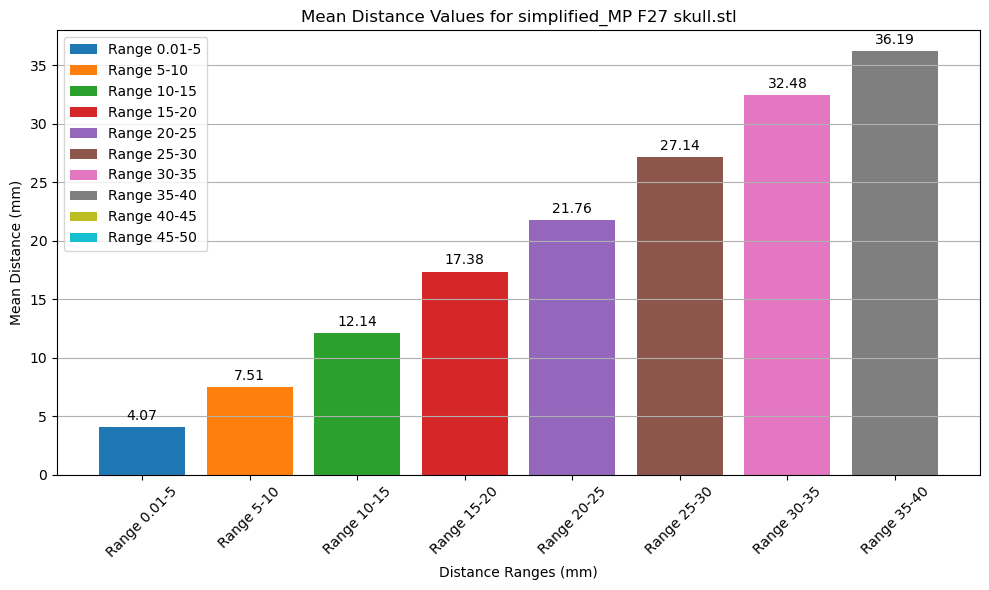

In [59]:
# Define the model you want to plot (example: 'F40 skull.stl')
model_to_plot = 'simplified_MP F27 skull.stl'

# Filter DataFrame for the specific model
model_data = df_distance_stats[df_distance_stats['Model'] == model_to_plot]

# Prepare data for plotting
ranges = []
mean_distances = []

for col in model_data.columns:
    if col.startswith('Range'):
        range_name = col.replace(' (mm)', '')
        ranges.append(range_name)
        
        # Extract and convert mean distances
        mean_distance_values = []
        for value in model_data[col]:
            try:
                # Convert string representation to dictionary
                mean_distance_dict = eval(value)
                mean_distance = mean_distance_dict.get('Mean Distance (mm)', np.nan)
                mean_distance_values.append(mean_distance)
            except Exception as e:
                print(f"Error parsing value: {value} - {e}")
                mean_distance_values.append(np.nan)  # Handle error gracefully
        
        mean_distances.append(mean_distance_values)

# Debugging output to check data
print("Ranges:", ranges)
print("Mean Distances:", mean_distances)

# Plotting
plt.figure(figsize=(10, 6))

# Iterate over each range and plot mean distances
bars = []
for i, range_name in enumerate(ranges):
    bars.append(plt.bar(range_name, mean_distances[i], label=range_name))

# Add mean distance annotations on each bar
for bar in bars:
    for rect in bar:
        height = rect.get_height()
        plt.annotate(f'{height:.2f}',
                     xy=(rect.get_x() + rect.get_width() / 2, height),
                     xytext=(0, 3),  # 3 points vertical offset
                     textcoords="offset points",
                     ha='center', va='bottom')

plt.xlabel('Distance Ranges (mm)')
plt.ylabel('Mean Distance (mm)')
plt.title(f'Mean Distance Values for {model_to_plot}')
plt.xticks(rotation=45)
plt.legend()
plt.grid(axis='y')
plt.tight_layout()
plt.show()

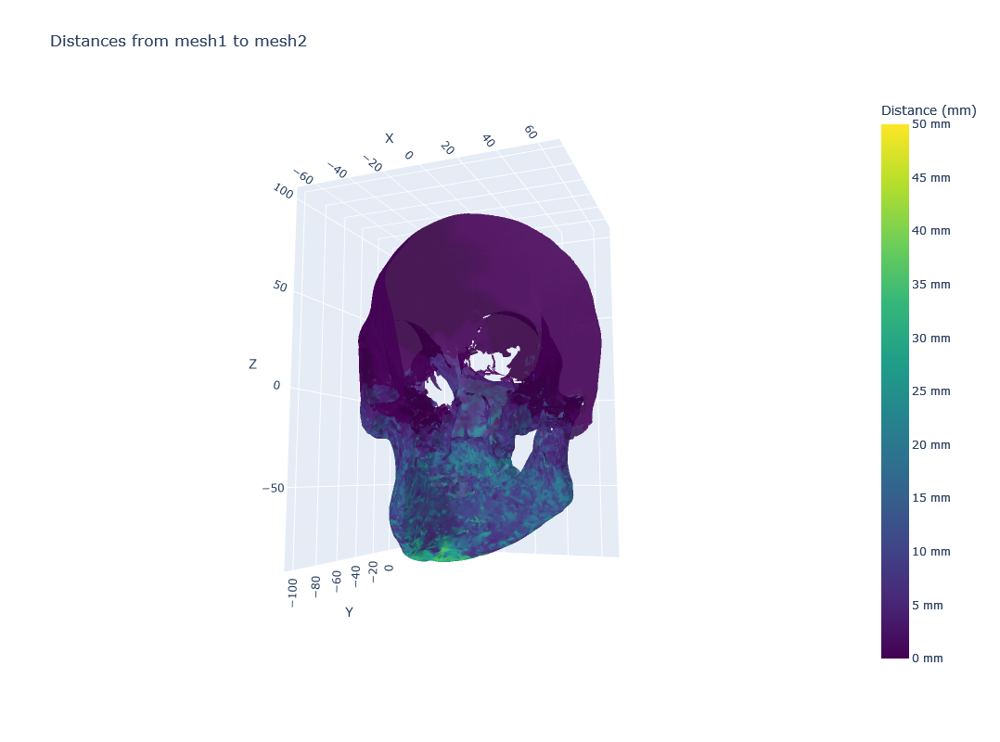

In [60]:
# Visualization

mesh1 = trimesh.load("models\\simplified_F1.5. F24 skull.stl")

vertices = mesh1.vertices
i, j, k = mesh1.faces.T

fig = go.Figure()

# Add the mesh
fig.add_trace(
    go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=i,
        j=j,
        k=k,
        intensity=distances,
        colorscale='Viridis',  # Use Plotly's built-in colorscale
        opacity=0.9,
        cmin=0,
        cmax=50,
        colorbar=dict(
            title='Distance (mm)',
            tickvals=np.arange(0, 51, 5),  # Tick values from 0 to 50 with a step of 5
            ticktext=[f'{val} mm' for val in np.arange(0, 51, 5)]  # Tick text in mm
        ),
        showscale=True  # Show the color scale (legend)
    )
)

# Update layout for a larger plot
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        camera=dict(
            eye=dict(x=1.25, y=1.25, z=1.25)  # Adjust camera position
        )
    ),
    title="Distances from mesh1 to mesh2",
    width=1200,  # Adjust the width of the figure
    height=800   # Adjust the height of the figure
)

fig.show()

In [14]:
# Hausdorff distances

# def vertex_hausdorff_distance(vertices1, vertices2):
#     # Compute directed Hausdorff distances from mesh1 to mesh2
#     directed_distances1 = np.min(cdist(mesh1.vertices, mesh2.vertices), axis=1)
    
#     # Compute directed Hausdorff distances from mesh2 to mesh1
#     directed_distances2 = np.min(cdist(mesh2.vertices, mesh1.vertices), axis=1)
    
#     # Compute symmetric Hausdorff distance for each vertex
#     symmetric_distances = np.maximum(directed_distances1, directed_distances2)
    
#     return symmetric_distances
    
def compute_vertex_hausdorff_distances(vertices1, vertices2):
    # Compute the pairwise distances between each vertex in vertices1 and all vertices in vertices2
    distances = cdist(vertices1, vertices2)
    
    # For each vertex in vertices1, find the minimum distance to any vertex in vertices2
    vertex_hausdorff_distances = np.min(distances, axis=1)
    
    return vertex_hausdorff_distances


mesh1 = trimesh.load('models\simplified_MP F27 skull.stl')
mesh2 = trimesh.load('models\simplified_MP F27 skin.stl')

# Get vertices from meshes
vertices1 = mesh1.vertices
vertices2 = mesh2.vertices

# Calculate vertex-wise Hausdorff distances
vertex_distances = compute_vertex_hausdorff_distances(vertices1, vertices2)



In [12]:
len(vertex_distances), vertex_distances[1000]

(40023, 11.929728345660866)

In [19]:
# Hausdorff distances

def compute_vertex_hausdorff_distances(vertices1, vertices2):
    # Compute the pairwise distances between each vertex in vertices1 and all vertices in vertices2
    distances = cdist(vertices1, vertices2)
    
    # For each vertex in vertices1, find the minimum distance to any vertex in vertices2
    vertex_hausdorff_distances = np.min(distances, axis=1)
    
    return vertex_hausdorff_distances


# Directory containing the mesh files
mesh_directory = './models'

# List all files in the directory
files = os.listdir(mesh_directory)

# Group files into pairs
mesh_pairs = []
for file in files:
    if 'simplified' in file:
        if 'skull' in file:
            skin_file = file.replace('skull', 'skin')
            if skin_file in files:
                mesh_pairs.append((file, skin_file))

# Dataframe to store distance statistics
hausdorff_distance_stats = []

# Define distance ranges
distance_ranges = [(0.01, 5), (5, 10), (10, 15), (15, 20), (20, 25), (25, 30), (30, 35), (35, 40), (40, 45), (45, 50)]

# Process each pair
for skull_file, skin_file in mesh_pairs:
    print(f"Processing {skull_file} and {skin_file}...")
    
    # Load the meshes
    mesh1 = trimesh.load(os.path.join(mesh_directory, skull_file))
    mesh2 = trimesh.load(os.path.join(mesh_directory, skin_file))
    
    # Get vertices from meshes
    vertices1 = mesh1.vertices
    vertices2 = mesh2.vertices

    # Calculate vertex-wise Hausdorff distances
    vertex_distances = compute_vertex_hausdorff_distances(vertices1, vertices2)

    stats_dict = {}
    
    # Calculate statistics for each range
    for distance_range in distance_ranges:
        range_min, range_max = distance_range
        range_distances = vertex_distances[(vertex_distances >= range_min) & (vertex_distances < range_max)]
        mean_distance = np.mean(range_distances)
        count_distance = len(range_distances)
        relative_count = (count_distance / len(vertex_distances)) * 100

        # Store statistics in dictionary
        stats_dict[f"Range {range_min}-{range_max} (mm)"] = {
            "Mean Distance (mm)": mean_distance,
            "Count": count_distance,
            "Relative Count (%)": relative_count
        }
        
    # Add pair stats to distance_stats list
    pair_stats = {
        "Model": skull_file,
        **stats_dict  # Unpack stats_dict into the dictionary
    }
    hausdorff_distance_stats.append(pair_stats)


# Create a dataframe and save it to a CSV file
df_hausdorff_distance_stats = pd.DataFrame(hausdorff_distance_stats)
df_hausdorff_distance_stats.to_csv(os.path.join(mesh_directory, 'hausdorff_distances_stats.csv'), index=False)

print("Hausdorff distance statistics saved to hausdorff_distance_stats.csv")

Processing simplified_F1.5. F24 skull.stl and simplified_F1.5. F24 skin.stl...
Processing simplified_F2.3. F27 skull.stl and simplified_F2.3. F27 skin.stl...
Processing simplified_F25 EH skull.stl and simplified_F25 EH skin.stl...
Processing simplified_F27 skull.stl and simplified_F27 skin.stl...
Processing simplified_F3.11. F31 skull.stl and simplified_F3.11. F31 skin.stl...
Processing simplified_F3.9. F34 skull.stl and simplified_F3.9. F34 skin.stl...
Processing simplified_F4.10. F37 skull.stl and simplified_F4.10. F37 skin.stl...
Processing simplified_F4.9. F35 skull.stl and simplified_F4.9. F35 skin.stl...
Processing simplified_F5.24. F43 skull.stl and simplified_F5.24. F43 skin.stl...
Processing simplified_F5.25. F44 skull.stl and simplified_F5.25. F44 skin.stl...
Processing simplified_M1.6. M23 skull.stl and simplified_M1.6. M23 skin.stl...
Processing simplified_M2.5. M25 skull.stl and simplified_M2.5. M25 skin.stl...
Processing simplified_M2.6. M29 skull.stl and simplified_M2.6.

In [22]:
df_hausdorff_distance_stats = pd.read_csv("models/hausdorff_distances_stats.csv")

# Function to parse dictionary-like string into a dictionary
def parse_stats_string(stats_str):
    try:
        return json.loads(stats_str.replace("'", '"'))  # Replace single quotes with double quotes for valid JSON
    except json.JSONDecodeError:
        return None

# Iterate through each row in the DataFrame
for index, row in df_hausdorff_distance_stats.iterrows():
    model = row['Model']
    print(f"Statistics for {model}:")
    
    # Iterate through each range and extract statistics
    for col in df_hausdorff_distance_stats.columns:
        if col.startswith('Range'):
            range_stats_str = row[col]
            range_name = col.replace(' (mm)', '')  # Remove '(mm)' from range name
            
            # Parse string representation into dictionary
            range_stats = parse_stats_string(range_stats_str)
            
            if range_stats:
                # Extract and print statistics
                print(f"{range_name}:")
                print(f"\tMean Distance (mm): {range_stats['Mean Distance (mm)']}")
                print(f"\tCount: {range_stats['Count']}")
                print(f"\tRelative Count (%): {range_stats['Relative Count (%)']}")
            else:
                print(f"{range_name}: Invalid format")
    
    print("\n")

Statistics for simplified_F1.5. F24 skull.stl:
Range 0.01-5:
	Mean Distance (mm): 3.7493631642292766
	Count: 4348
	Relative Count (%): 11.273010111485611
Range 5-10:
	Mean Distance (mm): 7.640106741541458
	Count: 6387
	Relative Count (%): 16.559502203785325
Range 10-15:
	Mean Distance (mm): 12.125986809292167
	Count: 7872
	Relative Count (%): 20.409644801659322
Range 15-20:
	Mean Distance (mm): 17.522542667748343
	Count: 5080
	Relative Count (%): 13.17085817993259
Range 20-25:
	Mean Distance (mm): 22.41839045980628
	Count: 4703
	Relative Count (%): 12.193414570910035
Range 25-30:
	Mean Distance (mm): 27.362458871560392
	Count: 3159
	Relative Count (%): 8.190303344568317
Range 30-35:
	Mean Distance (mm): 32.34235855410232
	Count: 2323
	Relative Count (%): 6.022815659839253
Range 35-40:
	Mean Distance (mm): 37.304177349139046
	Count: 1504
	Relative Count (%): 3.8994036816178377
Range 40-45:
	Mean Distance (mm): 42.53285667697291
	Count: 1249
	Relative Count (%): 3.2382680840031113
Range 

Ranges: ['Range 0.01-5', 'Range 5-10', 'Range 10-15', 'Range 15-20', 'Range 20-25', 'Range 25-30', 'Range 30-35', 'Range 35-40', 'Range 40-45', 'Range 45-50']
Mean Distances: [[4.000783294080308], [7.65539107799073], [12.329054464387367], [17.454368645929932], [22.272439244789684], [27.424012777553703], [32.37705540045292], [37.470331795022], [42.383837260986276], [47.27700802738499]]


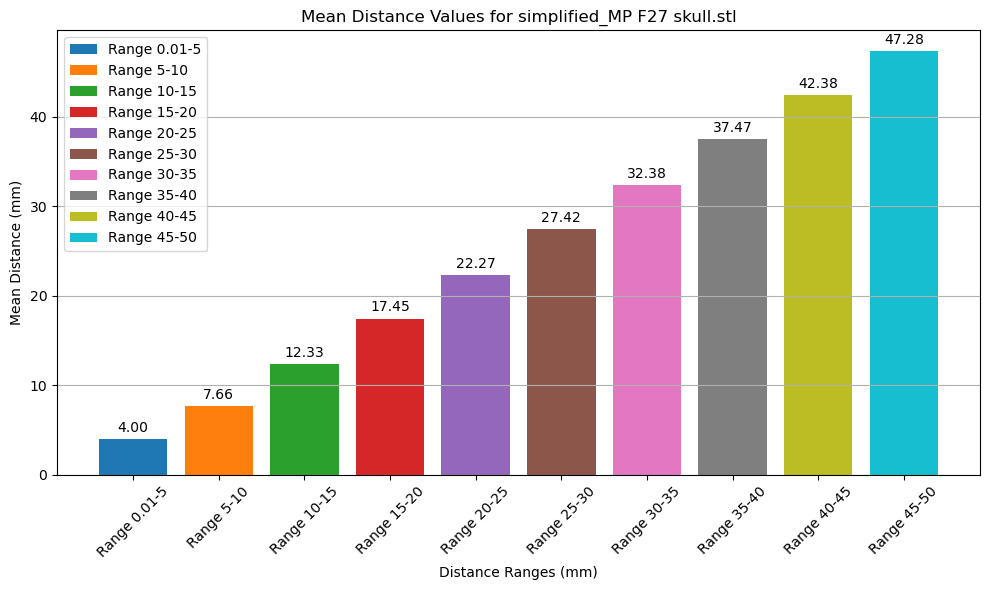

In [23]:
# Define the model you want to plot (example: 'simplified_MP F27 skull.stl')
model_to_plot = 'simplified_MP F27 skull.stl'

# Filter DataFrame for the specific model
model_data = df_hausdorff_distance_stats[df_hausdorff_distance_stats['Model'] == model_to_plot]

# Prepare data for plotting
ranges = []
mean_distances = []

for col in model_data.columns:
    if col.startswith('Range'):
        range_name = col.replace(' (mm)', '')
        ranges.append(range_name)
        
        # Extract and convert mean distances
        mean_distance_values = []
        for value in model_data[col]:
            try:
                # Convert string representation to dictionary
                mean_distance_dict = eval(value)
                mean_distance = mean_distance_dict.get('Mean Distance (mm)', np.nan)
                mean_distance_values.append(mean_distance)
            except Exception as e:
                print(f"Error parsing value: {value} - {e}")
                mean_distance_values.append(np.nan)  # Handle error gracefully
        
        mean_distances.append(mean_distance_values)

# Debugging output to check data
print("Ranges:", ranges)
print("Mean Distances:", mean_distances)

# Plotting
plt.figure(figsize=(10, 6))

# Iterate over each range and plot mean distances
bars = []
for i, range_name in enumerate(ranges):
    bars.append(plt.bar(range_name, mean_distances[i], label=range_name))

# Add mean distance annotations on each bar
for bar in bars:
    for rect in bar:
        height = rect.get_height()
        plt.annotate(f'{height:.2f}',
                     xy=(rect.get_x() + rect.get_width() / 2, height),
                     xytext=(0, 3),  # 3 points vertical offset
                     textcoords="offset points",
                     ha='center', va='bottom')

plt.xlabel('Distance Ranges (mm)')
plt.ylabel('Mean Distance (mm)')
plt.title(f'Mean Distance Values for {model_to_plot}')
plt.xticks(rotation=45)
plt.legend()
plt.grid(axis='y')
plt.tight_layout()
plt.show()

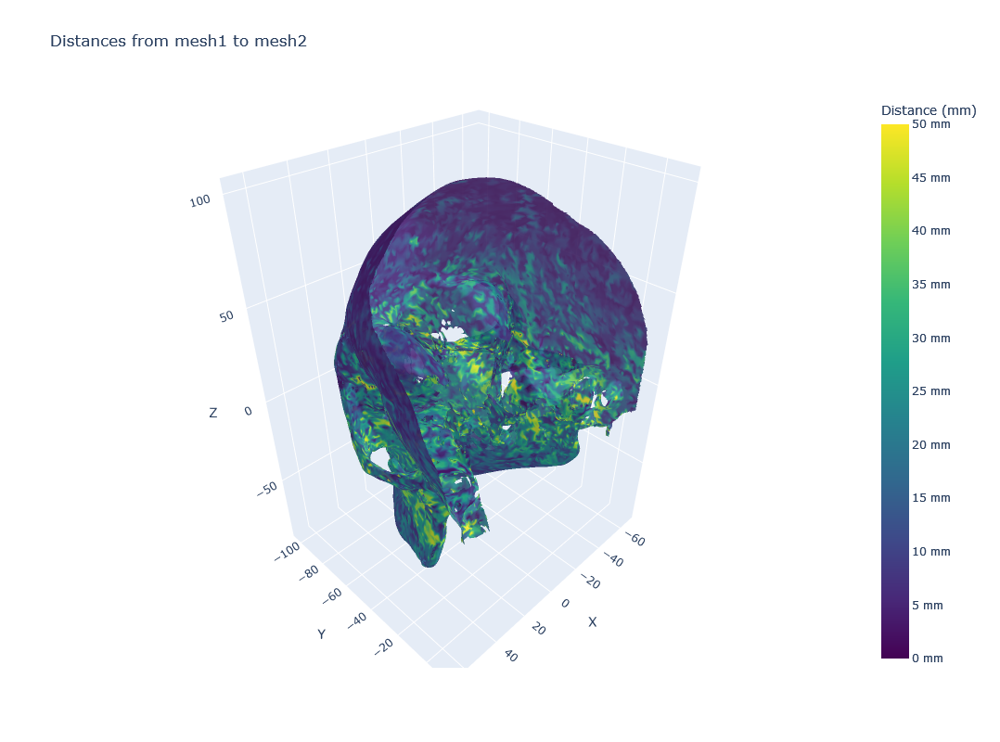

In [27]:
# Visualization

mesh1 = trimesh.load("models\\simplified_F1.5. F24 skull.stl")

vertices = mesh1.vertices
i, j, k = mesh1.faces.T

fig = go.Figure()

# Add the mesh
fig.add_trace(
    go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=i,
        j=j,
        k=k,
        intensity=vertex_distances,
        colorscale='Viridis',  # Use Plotly's built-in colorscale
        opacity=0.9,
        cmin=0,
        cmax=50,
        colorbar=dict(
            title='Distance (mm)',
            tickvals=np.arange(0, 51, 5),  # Tick values from 0 to 50 with a step of 5
            ticktext=[f'{val} mm' for val in np.arange(0, 51, 5)]  # Tick text in mm
        ),
        showscale=True  # Show the color scale (legend)
    )
)

# Update layout for a larger plot
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        camera=dict(
            eye=dict(x=1.25, y=1.25, z=1.25)  # Adjust camera position
        )
    ),
    title="Distances from mesh1 to mesh2",
    width=1200,  # Adjust the width of the figure
    height=800   # Adjust the height of the figure
)

fig.show()

In [24]:
# Second approach for calculating the mesh-to-mesh distances along normals of mesh1

 # Function to process rays in batches
def process_rays_in_batches(mesh1, mesh2, batch_size = 1000, max_distance = 50):
    # Calculate vertex normals for mesh1
    vertex_normals = mesh1.vertex_normals

    # Prepare rays for casting: origins at vertices, directions along normals
    ray_origins = mesh1.vertices
    ray_directions = vertex_normals

    num_vertices = ray_origins.shape[0]
    distances = np.full(num_vertices, np.nan)

    for start in range(0, num_vertices, batch_size):
        end = min(start + batch_size, num_vertices)
        batch_origins = ray_origins[start:end]
        batch_directions = ray_directions[start:end]

        # Cast rays from mesh1 to mesh2 for the current batch
        locations, index_ray, _ = mesh2.ray.intersects_location(ray_origins=batch_origins,
                                                                ray_directions=batch_directions,
                                                                multiple_hits=False)

        # Calculate distances where intersections occurred
        for i, ray_index in enumerate(index_ray):
            actual_index = start + ray_index
            distance = np.linalg.norm(locations[i] - batch_origins[ray_index])
            if distance <= max_distance:
                distances[actual_index] = distance

    return distances


# Directory containing the mesh files
mesh_directory = './models'

# List all files in the directory
files = os.listdir(mesh_directory)

# Group files into pairs
mesh_pairs = []
for file in files:
    if 'simplified' in file:
        if 'skull' in file:
            skin_file = file.replace('skull', 'skin')
            if skin_file in files:
                mesh_pairs.append((file, skin_file))

# Dataframe to store distance statistics
normal_distance_stats = []

# Define distance ranges
distance_ranges = [(0.01, 5), (5, 10), (10, 15), (15, 20), (20, 25), (25, 30), (30, 35), (35, 40), (40, 45), (45, 50)]

# Process each pair
for skull_file, skin_file in mesh_pairs:
    print(f"Processing {skull_file} and {skin_file}...")
    
    # Load the meshes
    mesh1 = trimesh.load(os.path.join(mesh_directory, skull_file))
    mesh2 = trimesh.load(os.path.join(mesh_directory, skin_file))
    
    # Process rays in batches to avoid MemoryError
    distances_d = process_rays_in_batches(mesh1, mesh2, batch_size = 1000, max_distance = 50)

    stats_dict = {}
    
    # Calculate statistics for each range
    for distance_range in distance_ranges:
        range_min, range_max = distance_range
        range_distances = distances_d[(distances_d >= range_min) & (distances_d < range_max)]
        mean_distance = np.mean(range_distances)
        count_distance = len(range_distances)
        relative_count = (count_distance / len(distances_d)) * 100

        # Store statistics in dictionary
        stats_dict[f"Range {range_min}-{range_max} (mm)"] = {
            "Mean Distance (mm)": mean_distance,
            "Count": count_distance,
            "Relative Count (%)": relative_count
        }
        
    # Add pair stats to distance_stats list
    pair_stats = {
        "Model": skull_file,
        **stats_dict  # Unpack stats_dict into the dictionary
    }
    normal_distance_stats.append(pair_stats)


# Create a dataframe and save it to a CSV file
df_normal_distance_stats = pd.DataFrame(normal_distance_stats)
df_normal_distance_stats.to_csv(os.path.join(mesh_directory, 'normal_distances_stats.csv'), index=False)

print("Distance statistics saved to distance_stats.csv")


Processing simplified_F1.5. F24 skull.stl and simplified_F1.5. F24 skin.stl...
Processing simplified_F2.3. F27 skull.stl and simplified_F2.3. F27 skin.stl...
Processing simplified_F25 EH skull.stl and simplified_F25 EH skin.stl...
Processing simplified_F27 skull.stl and simplified_F27 skin.stl...
Processing simplified_F3.11. F31 skull.stl and simplified_F3.11. F31 skin.stl...
Processing simplified_F3.9. F34 skull.stl and simplified_F3.9. F34 skin.stl...
Processing simplified_F4.10. F37 skull.stl and simplified_F4.10. F37 skin.stl...
Processing simplified_F4.9. F35 skull.stl and simplified_F4.9. F35 skin.stl...
Processing simplified_F5.24. F43 skull.stl and simplified_F5.24. F43 skin.stl...
Processing simplified_F5.25. F44 skull.stl and simplified_F5.25. F44 skin.stl...
Processing simplified_M1.6. M23 skull.stl and simplified_M1.6. M23 skin.stl...
Processing simplified_M2.5. M25 skull.stl and simplified_M2.5. M25 skin.stl...
Processing simplified_M2.6. M29 skull.stl and simplified_M2.6.

In [25]:
df_normal_distance_stats = pd.read_csv("models/normal_distances_stats.csv")

# Function to parse dictionary-like string into a dictionary
def parse_stats_string(stats_str):
    try:
        return json.loads(stats_str.replace("'", '"'))  # Replace single quotes with double quotes for valid JSON
    except json.JSONDecodeError:
        return None

# Iterate through each row in the DataFrame
for index, row in df_normal_distance_stats.iterrows():
    model = row['Model']
    print(f"Statistics for {model}:")
    
    # Iterate through each range and extract statistics
    for col in df_normal_distance_stats.columns:
        if col.startswith('Range'):
            range_stats_str = row[col]
            range_name = col.replace(' (mm)', '')  # Remove '(mm)' from range name
            
            # Parse string representation into dictionary
            range_stats = parse_stats_string(range_stats_str)
            
            if range_stats:
                # Extract and print statistics
                print(f"{range_name}:")
                print(f"\tMean Distance (mm): {range_stats['Mean Distance (mm)']}")
                print(f"\tCount: {range_stats['Count']}")
                print(f"\tRelative Count (%): {range_stats['Relative Count (%)']}")
            else:
                print(f"{range_name}: Invalid format")
    
    print("\n")

Statistics for simplified_F1.5. F24 skull.stl:
Range 0.01-5:
	Mean Distance (mm): 3.685483368203331
	Count: 3700
	Relative Count (%): 9.592947886958775
Range 5-10:
	Mean Distance (mm): 7.477938649834074
	Count: 3568
	Relative Count (%): 9.250712989369976
Range 10-15:
	Mean Distance (mm): 12.077432667362256
	Count: 4383
	Relative Count (%): 11.363754213119003
Range 15-20:
	Mean Distance (mm): 17.482295992312398
	Count: 2289
	Relative Count (%): 5.9346642468239565
Range 20-25:
	Mean Distance (mm): 22.272549649524613
	Count: 2072
	Relative Count (%): 5.372050816696914
Range 25-30:
	Mean Distance (mm): 27.501783857548922
	Count: 1081
	Relative Count (%): 2.802696396162821
Range 30-35:
	Mean Distance (mm): 32.39366216881778
	Count: 1086
	Relative Count (%): 2.8156598392533057
Range 35-40:
	Mean Distance (mm): 37.53803632389533
	Count: 981
	Relative Count (%): 2.5434275343531243
Range 40-45:
	Mean Distance (mm): 42.52546021219148
	Count: 847
	Relative Count (%): 2.196007259528131
Range 45-50

Ranges: ['Range 0.01-5', 'Range 5-10', 'Range 10-15', 'Range 15-20', 'Range 20-25', 'Range 25-30', 'Range 30-35', 'Range 35-40', 'Range 40-45', 'Range 45-50']
Mean Distances: [[3.994227475439972], [7.518705331124835], [12.146393141359631], [17.541070512613366], [22.11270227821869], [27.484618715014452], [32.458392872515084], [37.53783137046167], [42.68367360892783], [47.41865665078318]]


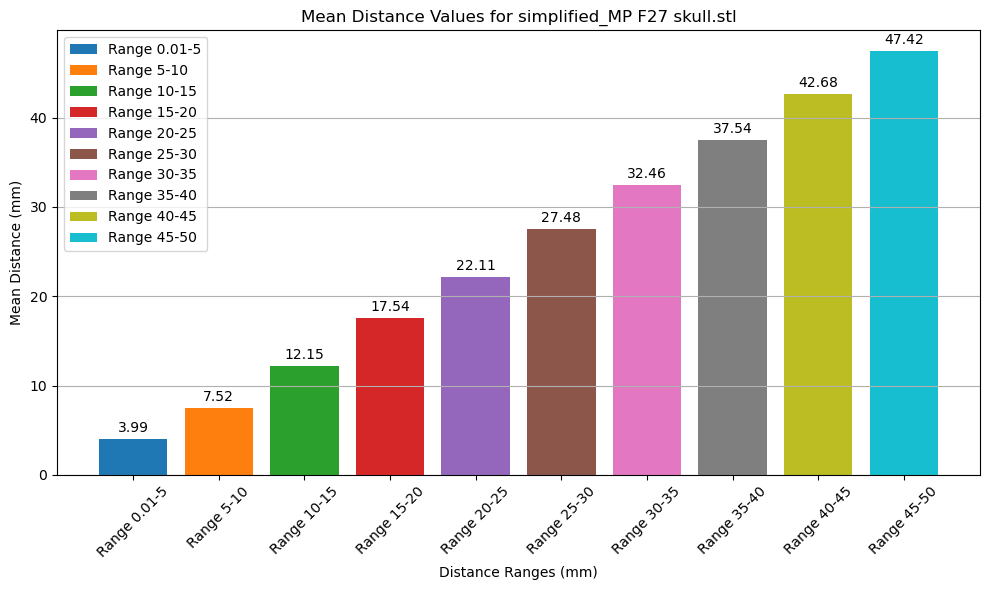

In [26]:
# Define the model you want to plot (example: 'simplified_MP F27 skull.stl')
model_to_plot = 'simplified_MP F27 skull.stl'

# Filter DataFrame for the specific model
model_data = df_normal_distance_stats[df_normal_distance_stats['Model'] == model_to_plot]

# Prepare data for plotting
ranges = []
mean_distances = []

for col in model_data.columns:
    if col.startswith('Range'):
        range_name = col.replace(' (mm)', '')
        ranges.append(range_name)
        
        # Extract and convert mean distances
        mean_distance_values = []
        for value in model_data[col]:
            try:
                # Convert string representation to dictionary
                mean_distance_dict = eval(value)
                mean_distance = mean_distance_dict.get('Mean Distance (mm)', np.nan)
                mean_distance_values.append(mean_distance)
            except Exception as e:
                print(f"Error parsing value: {value} - {e}")
                mean_distance_values.append(np.nan)  # Handle error gracefully
        
        mean_distances.append(mean_distance_values)

# Debugging output to check data
print("Ranges:", ranges)
print("Mean Distances:", mean_distances)

# Plotting
plt.figure(figsize=(10, 6))

# Iterate over each range and plot mean distances
bars = []
for i, range_name in enumerate(ranges):
    bars.append(plt.bar(range_name, mean_distances[i], label=range_name))

# Add mean distance annotations on each bar
for bar in bars:
    for rect in bar:
        height = rect.get_height()
        plt.annotate(f'{height:.2f}',
                     xy=(rect.get_x() + rect.get_width() / 2, height),
                     xytext=(0, 3),  # 3 points vertical offset
                     textcoords="offset points",
                     ha='center', va='bottom')

plt.xlabel('Distance Ranges (mm)')
plt.ylabel('Mean Distance (mm)')
plt.title(f'Mean Distance Values for {model_to_plot}')
plt.xticks(rotation=45)
plt.legend()
plt.grid(axis='y')
plt.tight_layout()
plt.show()

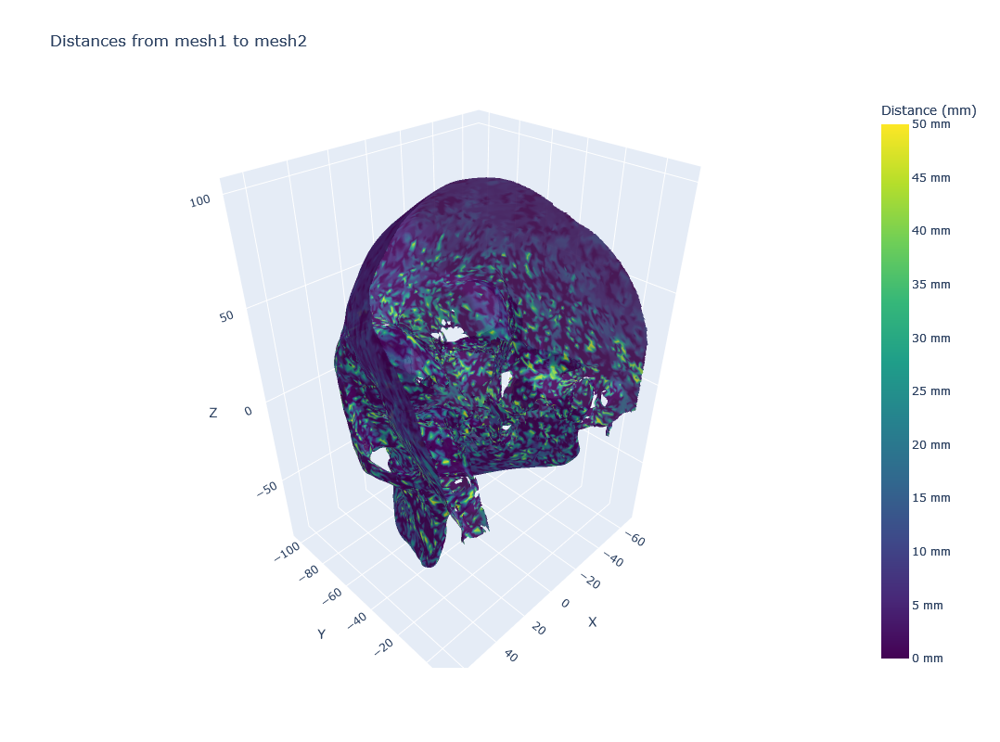

In [28]:
# Visualization

mesh1 = trimesh.load("models\\simplified_F1.5. F24 skull.stl")

vertices = mesh1.vertices
i, j, k = mesh1.faces.T

fig = go.Figure()

# Add the mesh
fig.add_trace(
    go.Mesh3d(
        x=vertices[:, 0],
        y=vertices[:, 1],
        z=vertices[:, 2],
        i=i,
        j=j,
        k=k,
        intensity=distances_d,
        colorscale='Viridis',  # Use Plotly's built-in colorscale
        opacity=0.9,
        cmin=0,
        cmax=50,
        colorbar=dict(
            title='Distance (mm)',
            tickvals=np.arange(0, 51, 5),  # Tick values from 0 to 50 with a step of 5
            ticktext=[f'{val} mm' for val in np.arange(0, 51, 5)]  # Tick text in mm
        ),
        showscale=True  # Show the color scale (legend)
    )
)

# Update layout for a larger plot
fig.update_layout(
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z'),
        camera=dict(
            eye=dict(x=1.25, y=1.25, z=1.25)  # Adjust camera position
        )
    ),
    title="Distances from mesh1 to mesh2",
    width=1200,  # Adjust the width of the figure
    height=800   # Adjust the height of the figure
)

fig.show()